In [3]:
from geosnap import DataStore
from segregation.dynamics import compute_multiscalar_profile
from geosnap import io as gio

In [2]:
datasets=DataStore()

/Users/knaaptime/mambaforge/envs/seg_networks/lib/python3.9/site-packages/geosnap/_data.py:66: UserWarning: The geosnap data storage class is provided for convenience only. The geosnap developers make no promises regarding data quality, consistency, or availability, nor are they responsible for any use/misuse of the data. The end-user is responsible for any and all analyses or applications created with the package.
  warn(


In [5]:
acs19 =  gio.get_acs(datasets, years=[2019], msa_fips='38300')

In [14]:
acs19.explore()

In [6]:
import pandana as pdna

In [7]:
net = pdna.Network.from_hdf5("/Users/knaaptime/Dropbox/projects/geosnap_data/metro_networks_8k/38300.h5")

Generating contraction hierarchies with 10 threads.
Setting CH node vector of size 272409
Setting CH edge vector of size 409631
Range graph removed 88312 edges of 819262
. 10% . 20% . 30% . 40% . 50% . 60% . 70% . 80% . 90% . 100%


In [8]:
import proplot as pplt

In [9]:
from segregation.multigroup import MultiInfoTheory

In [10]:
groups = ['n_nonhisp_white_persons', 'n_nonhisp_black_persons', 'n_hispanic_persons','n_asian_persons']

In [11]:
distances = list(range(500,5500,500))

In [12]:
compute_multiscalar_profile(acs19

Signature:
compute_multiscalar_profile(
    gdf,
    segregation_index=None,
    groups=None,
    group_pop_var=None,
    total_pop_var=None,
    distances=None,
    network=None,
    decay='linear',
    function='triangular',
    precompute=True,
    **kwargs,
)
Docstring:
Compute multiscalar segregation profile.

This function calculates several Spatial Information Theory indices with
increasing distance parameters.

Parameters
----------
gdf : geopandas.GeoDataFrame
    geodataframe with rows as observations and columns as population
    variables. Note that if using a network distance, the coordinate
    system for this gdf should be 4326. If using euclidian distance,
    this must be projected into planar coordinates like state plane or UTM.
segregation_index : SpatialImplicit SegregationIndex Class
    a class from the library such as MultiInformationTheory, or MinMax
groups : list
    list of population groups for calculating multigroup indices
group_pop_var : str
    name of po

In [15]:
euc_prof = compute_multiscalar_profile(acs19.to_crs(acs19.estimate_utm_crs()), MultiInfoTheory, groups, distances=distances)

In [16]:
euc_prof

distance
0       0.367349
500     0.355380
1000    0.288409
1500    0.227851
2000    0.187600
2500    0.159408
3000    0.138897
3500    0.123456
4000    0.111415
4500    0.101727
5000    0.093831
Name: MultiInfoTheory, dtype: float64

In [17]:
net_prof = compute_multiscalar_profile(acs19.to_crs(acs19.estimate_utm_crs()), MultiInfoTheory, groups, distances=distances, network=net)

In [18]:
net_prof

distance
0.0       0.367349
500.0     0.363151
1000.0    0.332886
1500.0    0.283977
2000.0    0.239500
2500.0    0.204335
3000.0    0.177305
3500.0    0.156077
4000.0    0.139050
4500.0    0.125660
5000.0    0.114963
Name: MultiInfoTheory, dtype: float64

In [29]:
import seaborn as sns
sns.set_context('paper')

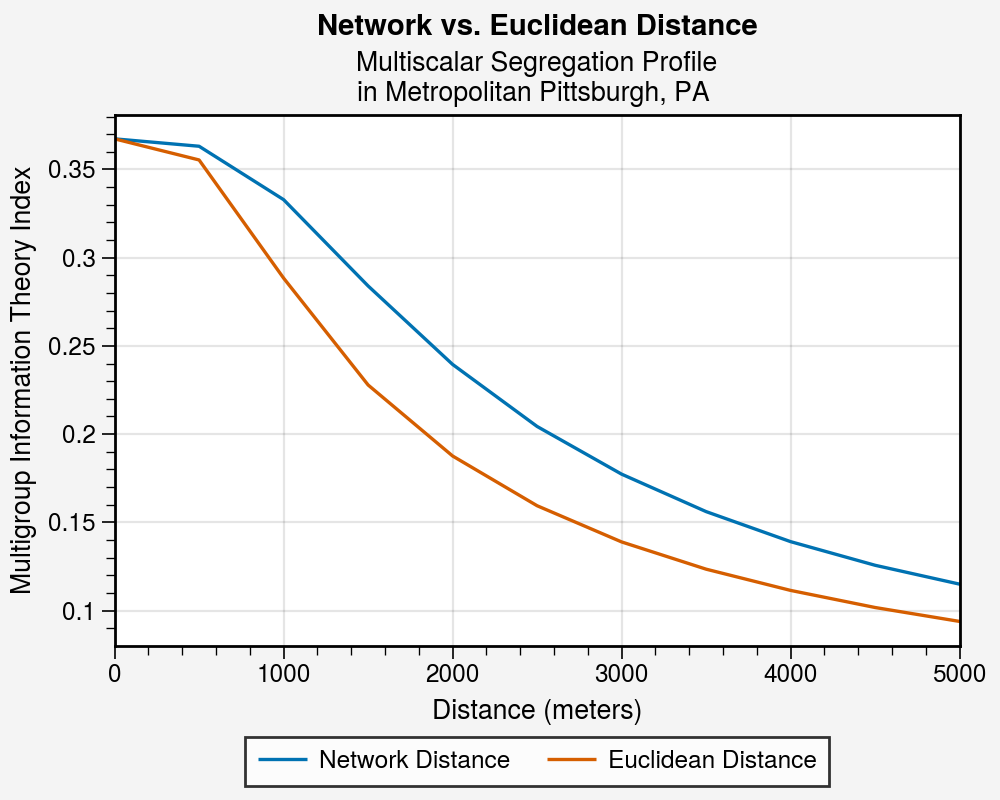

In [35]:
fig, ax = pplt.subplots(1,1, figsize=(5,4))

net_prof = net_prof.rename('Network Distance')
euc_prof = euc_prof.rename('Euclidean Distance')

net_prof.plot(ax=ax)
euc_prof.plot(ax=ax)
ax.set_xlabel('Distance (meters)')
ax.set_ylabel('Multigroup Information Theory Index')

ax.legend(loc='b')
ax.set_title('Multiscalar Segregation Profile\nin Metropolitan Pittsburgh, PA ')
fig.suptitle('Network vs. Euclidean Distance')
fig.savefig('../paper/figures/pitt_example.png')